# Design Flex probe with reverse SP6 promoter

by Pu Zheng

2025.6.5

In [1]:
# minimal system packages:
import os, pickle
from time import localtime
from Bio.Seq import reverse_complement
import pandas as pd

In [2]:
# temporary:
from importlib import reload

In [3]:
# Define folders:
library_master_folder = r'/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes'
if not os.path.exists(library_master_folder):
    os.makedirs(library_master_folder)
print(f"- FISH probe libraries stored in folder: {library_master_folder}")

reference_folder = r'/lab/solexa_weissman/puzheng/References'
print(os.listdir(os.path.join(reference_folder, 'GRCm39')))


- FISH probe libraries stored in folder: /lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes
['.DS_Store', 'RefSeq', 'CDS', 'gencode_version', 'Transcriptome', 'Genome', 'dna', 'gencode.vM37.chr_patch_hapl_scaff.annotation.gtf', 'gencode.vM37.transcripts.fa', 'GRCm39.genome.fa.gz', 'gencode.vM37.chr_patch_hapl_scaff.annotation.gff3']


In [4]:
# library specific folders:
library_folder = os.path.join(library_master_folder, 'SP6_mouse_transcriptome_batch2', )
print(f"- library will be saved in: {library_folder}")
if not os.path.exists(library_folder):
    os.makedirs(library_folder)
    print(f"-- create library_folder: {library_folder}")
probe_output_file = os.path.join(library_folder, 'designed_probes.csv')
print(f"-- library savefile: {probe_output_file}")
probe_output_idt_file = os.path.join(library_folder, 'designed_probes_idt_oPool.xlsx')
print(f"-- library IDT format savefile: {probe_output_idt_file}")

- library will be saved in: /lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2
-- library savefile: /lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/designed_probes.csv
-- library IDT format savefile: /lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/designed_probes_idt_oPool.xlsx


In [5]:
# Define transcriptome reference
mRNA_fasta_file = os.path.join(reference_folder, 'GRCm39', 
                                      r'gencode.vM37.transcripts.fa')
#ncRNA_fasta_file = os.path.join(reference_folder, 'GRCm39', 'Transcriptome',
#                                      r'Mus_musculus.GRCm39.ncrna.fa')
gff3_file = os.path.join(reference_folder, 'GRCm39', 'Transcriptome',
                                      r'Mus_musculus.GRCm39.109.gff3')

# load biomart reference:
biomart_ref_filename = r'/lab/solexa_weissman/puzheng/References/BioMart/mouse_ensembl_coding_Appris.csv'
biomart_df = pd.read_csv(biomart_ref_filename)

In [ ]:
biomart_df

## Packages

In [6]:
import numpy as np
import pandas as pd

from IPython.display import display

import MERFISH_probe_design.IO.file_io as fio
import MERFISH_probe_design.probe_design.probe_dict as p_d
import MERFISH_probe_design.probe_design.OTTable_dict as ot
import MERFISH_probe_design.probe_design.readout_sequences as rs
import MERFISH_probe_design.probe_design.probe_selection as ps
import MERFISH_probe_design.probe_design.quality_check as qc
from MERFISH_probe_design.probe_design import filters
from MERFISH_probe_design.probe_design import plot
from MERFISH_probe_design.probe_design import primer_design
from MERFISH_probe_design.probe_design import flex_probe_dict

# Design targeting sequences:

## load transcriptome

In [7]:
# Load the transcriptome as a pandas data frame
transcriptome = fio.load_transcriptome(mRNA_fasta_file, None, style='gencode')

Loaded 278369 transcripts.
return gencode style transcriptome
{'transcript_id': 'ENSMUST00000193812.2', 'gene_id': 'ENSMUSG00000102693.2', 'havana_gene': 'OTTMUSG00000049935.1', 'havana_transcript': 'OTTMUST00000127109.1', 'transcript_name': '4933401J01Rik-201', 'gene_name': '4933401J01Rik', 'length': '1070', 'transcript_type': 'TEC'}


In [8]:
transcriptome.head()

,transcript_id,gene_id,havana_gene,havana_transcript,transcript_name,gene_short_name,length,transcript_type,sequence,FPKM
0,ENSMUST00000193812.2,ENSMUSG00000102693.2,OTTMUSG00000049935.1,OTTMUST00000127109.1,4933401J01Rik-201,4933401J01Rik,1070,TEC,AAGGAAAGAGGATAACACTTGAAATGTAAATAAAGAAAATACCTAA...,1
1,ENSMUST00000082908.3,ENSMUSG00000064842.3,-,-,Gm26206-201,Gm26206,110,snRNA,GTGCTTGCTTCGGCAACACATACACTAAATTTTGAACGATACAGAG...,1
2,ENSMUST00000162897.2,ENSMUSG00000051951.6,OTTMUSG00000026353.2,OTTMUST00000086625.1,Xkr4-203,Xkr4,4153,protein_coding_CDS_not_defined,GCACACTACGGTCCATCTCCAACAACCGCAGTGTTGCCAGTGACCG...,1
3,ENSMUST00000159265.2,ENSMUSG00000051951.6,OTTMUSG00000026353.2,OTTMUST00000086624.1,Xkr4-202,Xkr4,2989,protein_coding_CDS_not_defined,TTAGTTAAGAGCACTGACTGCTCTTGCAAAGGACCCAGGCTTGAGT...,1
4,ENSMUST00000070533.5,ENSMUSG00000051951.6,OTTMUSG00000026353.2,OTTMUST00000065166.1,Xkr4-201,Xkr4,3634,protein_coding,GCGGCGGCGGGCGAGCGGGCGCTGGAGTAGGAGCTGGGGAGCGGCG...,1


## Select genes

In [9]:
len(biomart_df)

33107

## Based on gff3 reference and bioMart, keep only well-annotated genes

In [15]:
# For the selected gene_ids, laod gff3
import sys
sys.path.append(r"/lab/weissman_imaging/puzheng/Softwares")
from ChromAn.src.sequence_tools.reference_io import gff3_reader
gff3_ref = gff3_reader(gff3_file, save=True, save_filename=os.path.join(library_folder, 'gff3_info.pkl'),
                       auto_read=True)

- loading from save_file: /lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/gff3_info.pkl
parsing all gene information
gene:ENSMUSG00000102693
gene:ENSMUSG00000064842
gene:ENSMUSG00000051951
gene:ENSMUSG00000102851
gene:ENSMUSG00000103377
gene:ENSMUSG00000104017
gene:ENSMUSG00000103025
gene:ENSMUSG00000089699
gene:ENSMUSG00000103201
gene:ENSMUSG00000103147
gene:ENSMUSG00000103161
gene:ENSMUSG00000102331
gene:ENSMUSG00000102348
gene:ENSMUSG00000102592
gene:ENSMUSG00000088333
gene:ENSMUSG00000102343
gene:ENSMUSG00000025900
gene:ENSMUSG00000102948
gene:ENSMUSG00000104123
gene:ENSMUSG00000025902
gene:ENSMUSG00000104238
gene:ENSMUSG00000102269
gene:ENSMUSG00000118917
gene:ENSMUSG00000103003
gene:ENSMUSG00000104328
gene:ENSMUSG00000102735
gene:ENSMUSG00000098104
gene:ENSMUSG00000102175
gene:ENSMUSG00002075947
gene:ENSMUSG00000103265
gene:ENSMUSG00000103922
gene:ENSMUSG00000033845
gene:ENSMUSG00000102275
gene:ENSMUSG00000120403
gene:ENSMUSG00000025903
gene

In [16]:
biomart_df.head()

,Gene stable ID,Gene stable ID version,Transcript stable ID,Transcript stable ID version
0,ENSMUSG00000064341,ENSMUSG00000064341.1,ENSMUST00000082392,ENSMUST00000082392.1
1,ENSMUSG00000064345,ENSMUSG00000064345.1,ENSMUST00000082396,ENSMUST00000082396.1
2,ENSMUSG00000064351,ENSMUSG00000064351.1,ENSMUST00000082402,ENSMUST00000082402.1
3,ENSMUSG00000064354,ENSMUSG00000064354.1,ENSMUST00000082405,ENSMUST00000082405.1
4,ENSMUSG00000064356,ENSMUSG00000064356.1,ENSMUST00000082407,ENSMUST00000082407.1


In [17]:
unique_coding_genes = np.unique(transcriptome.loc[transcriptome['transcript_type']=='protein_coding', 'gene_id'])
unique_coding_biomart_transcripts = {'gene_id':[],'transcript_id':[]}
for _g in unique_coding_genes:
    if _g.split('.')[0] in biomart_df['Gene stable ID'].values:
        _transcript_ids = biomart_df.loc[biomart_df['Gene stable ID']==_g.split('.')[0], 'Transcript stable ID'].values
        unique_coding_biomart_transcripts['gene_id'].append(_g)
        unique_coding_biomart_transcripts['transcript_id'].extend(list(_transcript_ids))
    else:
        #pass
        print(_g)

ENSMUSG00000062783.3
ENSMUSG00000074720.2
ENSMUSG00000079190.4
ENSMUSG00000079192.3
ENSMUSG00000079222.3
ENSMUSG00000079794.3
ENSMUSG00000079800.3
ENSMUSG00000079808.4
ENSMUSG00000091585.3
ENSMUSG00000094172.2
ENSMUSG00000094303.2
ENSMUSG00000094337.8
ENSMUSG00000094383.2
ENSMUSG00000094474.2
ENSMUSG00000094514.2
ENSMUSG00000094722.2
ENSMUSG00000094728.2
ENSMUSG00000094741.2
ENSMUSG00000094791.2
ENSMUSG00000094799.2
ENSMUSG00000094836.2
ENSMUSG00000094855.2
ENSMUSG00000094874.2
ENSMUSG00000094887.2
ENSMUSG00000094915.2
ENSMUSG00000095019.2
ENSMUSG00000095041.8
ENSMUSG00000095092.2
ENSMUSG00000095250.2
ENSMUSG00000095450.2
ENSMUSG00000095475.2
ENSMUSG00000095500.2
ENSMUSG00000095505.2
ENSMUSG00000095523.2
ENSMUSG00000095570.2
ENSMUSG00000095666.2
ENSMUSG00000095672.2
ENSMUSG00000095763.2
ENSMUSG00000095787.2
ENSMUSG00000096100.2
ENSMUSG00000096236.2
ENSMUSG00000096244.2
ENSMUSG00000096550.2
ENSMUSG00000096680.2
ENSMUSG00000096728.2
ENSMUSG00000096756.2
ENSMUSG00000096776.2
ENSMUSG000000

In [18]:
len(unique_coding_biomart_transcripts['gene_id'])

21585

In [19]:
# select transcriptome:
sel_vec = [_t.split('.')[0] in unique_coding_biomart_transcripts['transcript_id'] 
           for _t in transcriptome['transcript_id']]
# select
sel_transcriptome = transcriptome.loc[sel_vec]

In [20]:
sel_genes = list(np.unique(sel_transcriptome['gene_short_name']))

## NOTE: run everything above even needs to load the probe_dict from pickle

## Initialize probe dict

In [ ]:
# Initialize the probe dictionary which is the carrier of the probes throught the design process.
probe_dict = p_d.init_probe_dict(list(np.unique(sel_transcriptome['gene_short_name'])), 
                                 sel_transcriptome, 
                                 'gene_short_name', K=50) # NOTE: Flex probes are 50-mers
p_d.print_probe_dict(probe_dict)

In [ ]:
# within probe_dict, keep only the coding isoforms:
for _gene, _transcript_2_probes in probe_dict.items():
    probe_dict[_gene] = {k: v for k, v in _transcript_2_probes.items()
                         if k in sel_transcriptome['transcript_id'].values}
p_d.print_probe_dict(probe_dict)

In [ ]:
filters.calc_GC_for_left_probe_dict(probe_dict, left_length=25,
                            column_key_seq='target_sequence',
                            column_key_write='target_GC_left')
plot.plot_hist(probe_dict, column_key=f'target_GC_left{25}')

In [ ]:
filters.calc_GC_for_right_probe_dict(probe_dict, right_length=25,
                            column_key_seq='target_sequence',
                            column_key_write='target_GC_right')
plot.plot_hist(probe_dict, column_key=f'target_GC_right{25}')

In [ ]:
filters.filter_probe_dict_by_metric(probe_dict, f'target_GC_left{25}', lower_bound=44, upper_bound=72)
plot.plot_hist(probe_dict, column_key=f'target_GC_left{25}', bins=30)

In [ ]:
filters.filter_probe_dict_by_metric(probe_dict, f'target_GC_right{25}', lower_bound=44, upper_bound=72)
plot.plot_hist(probe_dict, column_key=f'target_GC_right{25}', bins=30)

In [ ]:
# calculate base 25 to be G:
filters.calc_base_at_location_probe_dict(probe_dict, location=25,
                                  column_key_seq='target_sequence',
                                  column_key_write='target_base_at_location')
plot.plot_hist(probe_dict, column_key=f'target_base_at_location{25}', bins=10)

In [ ]:
# kept only G:
filters.filter_probe_dict_by_metric(probe_dict, f'target_base_at_location{25}', 
                                      lower_bound=3.99, upper_bound=4.01)

In [ ]:
filters.detect_homopolymer_probe_dict(probe_dict,
                              column_key_seq='target_sequence',
                              min_length=5,
                              column_key_write='has_homopolymer')

plot.plot_hist(probe_dict, column_key=f'has_homopolymer{5}', bins=10)

In [ ]:
# kept only no homopolymers probes:
filters.filter_probe_dict_by_metric(probe_dict, f'has_homopolymer{5}', 
                                    upper_bound=0.01)

In [ ]:
# save pb_dict in case of jupyter crashing:

probe_dict_filename = os.path.join(
    library_folder, 
    f'{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_temp_probe_dict.pkl')

print(probe_dict_filename)
pickle.dump(probe_dict, open(probe_dict_filename,'wb'))

## Calculate off-targets

In [12]:
# restart:
probe_dict = pickle.load(open(os.path.join(library_folder,'2025_7_30_temp_probe_dict.pkl'),'rb'))

### Generate CountTable

In [13]:
# Initialize the off-target counting tables
overwrite_ottable = False
# OTTable for rRNA/tRNAs
if 'ottable_rtRNAs' not in locals() or overwrite_ottable:
    ottable_rtRNAs = ot.get_OTTable_for_rtRNAs(transcriptome, 15, search_column='transcript_type')

Found 378 rRNAs/tRNAs from 278369 non-coding RNAs.


In [21]:
# OTTables for the genes we target
if 'gene_ottable_dict' not in locals() or overwrite_ottable:
    #gene_ottable_dict = ot.get_gene_OTTables(transcriptome, sel_isoform_names, 'transcript_id', 17)
    gene_ottable_dict = ot.get_gene_OTTables(transcriptome, sel_genes, 'gene_short_name', 17)

Generate OTTable for gene 0610010K14Rik.
Construct a OTTable using 14/14 transcripts with FPKM > 0.
Generate OTTable for gene 0610030E20Rik.
Construct a OTTable using 4/4 transcripts with FPKM > 0.
Generate OTTable for gene 0610040J01Rik.
Construct a OTTable using 4/4 transcripts with FPKM > 0.
Generate OTTable for gene 1110002E22Rik.
Construct a OTTable using 2/2 transcripts with FPKM > 0.
Generate OTTable for gene 1110004F10Rik.
Construct a OTTable using 6/6 transcripts with FPKM > 0.
Generate OTTable for gene 1110032F04Rik.
Construct a OTTable using 1/1 transcripts with FPKM > 0.
Generate OTTable for gene 1110038F14Rik.
Construct a OTTable using 4/4 transcripts with FPKM > 0.
Generate OTTable for gene 1110059E24Rik.
Construct a OTTable using 9/9 transcripts with FPKM > 0.
Generate OTTable for gene 1110059G10Rik.
Construct a OTTable using 3/3 transcripts with FPKM > 0.
Generate OTTable for gene 1110065P20Rik.
Construct a OTTable using 6/6 transcripts with FPKM > 0.
Generate OTTable f

In [22]:
# OTTable for the transcriptome.
if 'ottable_transcriptome' not in locals() or overwrite_ottable:
    ottable_transcriptome = ot.get_OTTable_for_transcriptome(transcriptome, 17)


Construct a OTTable using 278369/278369 transcripts with FPKM > 0.
Processed 10000/278369 sequences.
Processed 20000/278369 sequences.
Processed 30000/278369 sequences.
Processed 40000/278369 sequences.
Processed 50000/278369 sequences.
Processed 60000/278369 sequences.
Processed 70000/278369 sequences.
Processed 80000/278369 sequences.
Processed 90000/278369 sequences.
Processed 100000/278369 sequences.
Processed 110000/278369 sequences.
Processed 120000/278369 sequences.
Processed 130000/278369 sequences.
Processed 140000/278369 sequences.
Processed 150000/278369 sequences.
Processed 160000/278369 sequences.
Processed 170000/278369 sequences.
Processed 180000/278369 sequences.
Processed 190000/278369 sequences.
Processed 200000/278369 sequences.
Processed 210000/278369 sequences.
Processed 220000/278369 sequences.
Processed 230000/278369 sequences.
Processed 240000/278369 sequences.
Processed 250000/278369 sequences.
Processed 260000/278369 sequences.
Processed 270000/278369 sequence

### Off-targets to rRNA/tRNAs

In [23]:
# Calculate and plot the off-targets to rRNA/tRNAs
ot.calc_OTs(probe_dict, ottable_rtRNAs, 'target_sequence', 'target_OT_rtRNA', 15)
#plot.plot_hist(probe_dict, 'target_OT_rtRNA', y_max=400)
# Filter out probes that have any rRNA/tRNA off-targets
filters.filter_probe_dict_by_metric(probe_dict, 'target_OT_rtRNA', upper_bound=0.5)
#plot.plot_hist(probe_dict, 'target_OT_rtRNA')

Calculate OTs for 0/21565 genes.
Calculate OTs for 215/21565 genes.
Calculate OTs for 430/21565 genes.
Calculate OTs for 645/21565 genes.
Calculate OTs for 860/21565 genes.
Calculate OTs for 1075/21565 genes.
Calculate OTs for 1290/21565 genes.
Calculate OTs for 1505/21565 genes.
Calculate OTs for 1720/21565 genes.
Calculate OTs for 1935/21565 genes.
Calculate OTs for 2150/21565 genes.
Calculate OTs for 2365/21565 genes.
Calculate OTs for 2580/21565 genes.
Calculate OTs for 2795/21565 genes.
Calculate OTs for 3010/21565 genes.
Calculate OTs for 3225/21565 genes.
Calculate OTs for 3440/21565 genes.
Calculate OTs for 3655/21565 genes.
Calculate OTs for 3870/21565 genes.
Calculate OTs for 4085/21565 genes.
Calculate OTs for 4300/21565 genes.
Calculate OTs for 4515/21565 genes.
Calculate OTs for 4730/21565 genes.
Calculate OTs for 4945/21565 genes.
Calculate OTs for 5160/21565 genes.
Calculate OTs for 5375/21565 genes.
Calculate OTs for 5590/21565 genes.
Calculate OTs for 5805/21565 genes.

### Off-targets to transcriptome

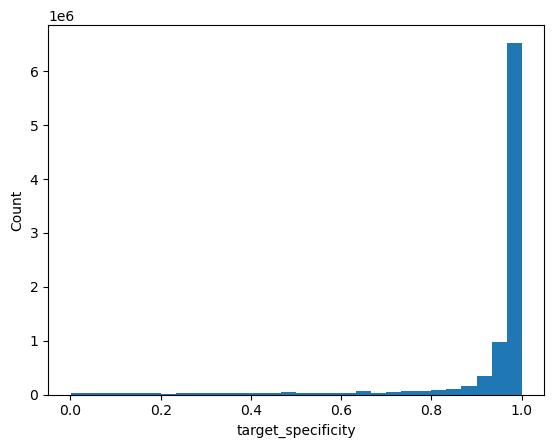

In [24]:
# Get the FPKMs of the transcripts
transcript_fpkms = dict(zip(list(transcriptome['transcript_id']), list(transcriptome['FPKM'])))

# Calculate the specificities and isoform specificities of the target regions
ot.calc_specificity(probe_dict, ottable_transcriptome, gene_ottable_dict, transcript_fpkms,
                    'target_sequence', 'target_specificity', 'target_isospecificity', 17)

plot.plot_hist(probe_dict, 'target_specificity')

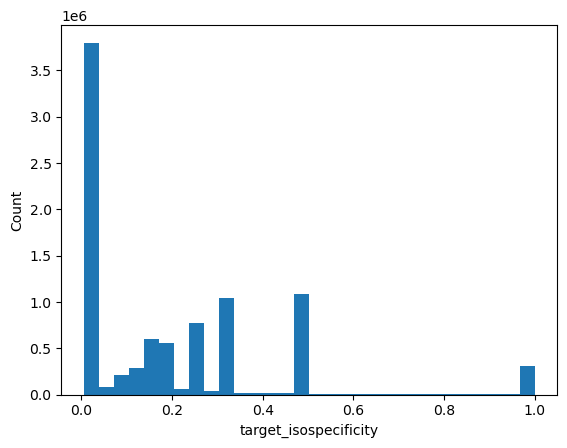

In [25]:
# modify target isospecificity, if only one isoform exist:
for _gene, _transcript_2_df in probe_dict.items():
    if len(_transcript_2_df) == 1:
        for _transcript, _df in _transcript_2_df.items():
            probe_dict[_gene][_transcript]['target_isospecificity'] = 0.01
plot.plot_hist(probe_dict, 'target_isospecificity')

Xkr4
	ENSMUST00000070533.5: 126 / 269 probes passed the filter 0.99 < target_specificity <  inf.
Rp1
	ENSMUST00000208660.2: 172 / 290 probes passed the filter 0.99 < target_specificity <  inf.
Sox17
	ENSMUST00000027035.10: 125 / 178 probes passed the filter 0.99 < target_specificity <  inf.
	ENSMUST00000116652.8: 97 / 139 probes passed the filter 0.99 < target_specificity <  inf.
Mrpl15
	ENSMUST00000156816.7: 120 / 315 probes passed the filter 0.99 < target_specificity <  inf.
Lypla1
	ENSMUST00000027036.11: 5 / 74 probes passed the filter 0.99 < target_specificity <  inf.
Tcea1
	ENSMUST00000081551.14: 5 / 68 probes passed the filter 0.99 < target_specificity <  inf.
Rgs20
	ENSMUST00000002533.15: 44 / 77 probes passed the filter 0.99 < target_specificity <  inf.
	ENSMUST00000119256.8: 54 / 78 probes passed the filter 0.99 < target_specificity <  inf.
Atp6v1h
	ENSMUST00000192698.3: 67 / 105 probes passed the filter 0.99 < target_specificity <  inf.
Oprk1
	ENSMUST00000160777.8: 94 / 160 p

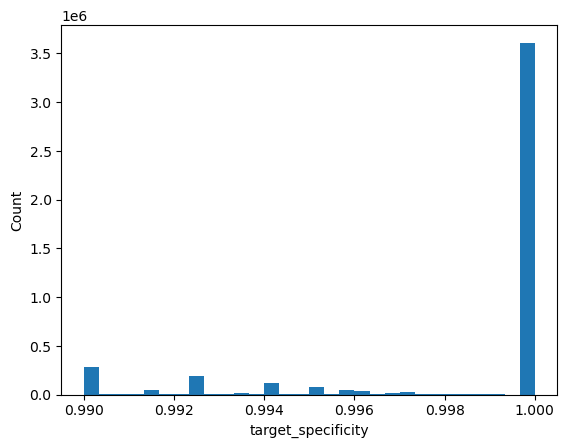

In [26]:
# Filter the specificities of the target regions
# Here we allow the probes to target other isoforms
# Don't allow any gene-level off-targets
filters.filter_probe_dict_by_metric(probe_dict, 'target_specificity', lower_bound=0.99)
plot.plot_hist(probe_dict, 'target_specificity')

Xkr4
	ENSMUST00000070533.5: 126 / 126 probes passed the filter 0.0 < target_isospecificity <  0.66.
Rp1
	ENSMUST00000208660.2: 172 / 172 probes passed the filter 0.0 < target_isospecificity <  0.66.
Sox17
	ENSMUST00000027035.10: 125 / 125 probes passed the filter 0.0 < target_isospecificity <  0.66.
	ENSMUST00000116652.8: 97 / 97 probes passed the filter 0.0 < target_isospecificity <  0.66.
Mrpl15
	ENSMUST00000156816.7: 120 / 120 probes passed the filter 0.0 < target_isospecificity <  0.66.
Lypla1
	ENSMUST00000027036.11: 5 / 5 probes passed the filter 0.0 < target_isospecificity <  0.66.
Tcea1
	ENSMUST00000081551.14: 5 / 5 probes passed the filter 0.0 < target_isospecificity <  0.66.
Rgs20
	ENSMUST00000002533.15: 37 / 44 probes passed the filter 0.0 < target_isospecificity <  0.66.
	ENSMUST00000119256.8: 32 / 54 probes passed the filter 0.0 < target_isospecificity <  0.66.
Atp6v1h
	ENSMUST00000192698.3: 67 / 67 probes passed the filter 0.0 < target_isospecificity <  0.66.
Oprk1
	ENSMUS

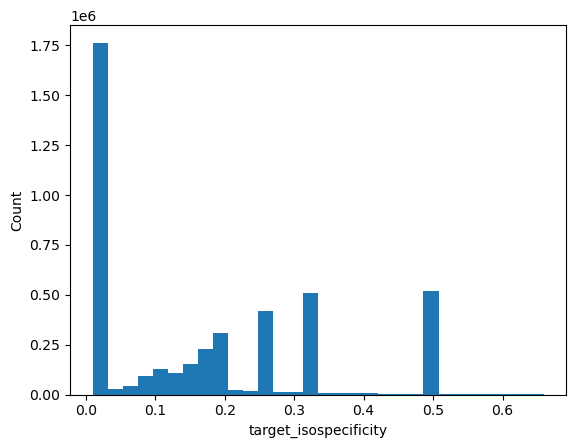

In [27]:
# Here we allow the probes to target other isoforms
# Don't allow any gene-level off-targets
filters.filter_probe_dict_by_metric(probe_dict, 'target_isospecificity', 
                                    lower_bound=0., upper_bound=0.66)
plot.plot_hist(probe_dict, 'target_isospecificity')

## Select the transcript with the most probes

In [28]:
probe_dict = {_g:_dict for _g,_dict in probe_dict.items() if len(_dict) > 0}

In [29]:
select_transcripts = True
if select_transcripts:
    # Manual selection
    #probe_dict = p_d.select_transcripts_by_ids(probe_dict, transcript_ids=['ENSMUST00000003100.10', ])
    # Select the transcript with most probes passed QC:
    probe_dict = p_d.select_transcripts_by_num_probes(probe_dict)
    p_d.print_probe_dict(probe_dict) # We excluded all the transcripts that are not our direct targets


Gene	Transcript	N_probes
Xkr4
	ENSMUST00000070533.5	126
Rp1
	ENSMUST00000208660.2	172
Sox17
	ENSMUST00000027035.10	125
Mrpl15
	ENSMUST00000156816.7	120
Lypla1
	ENSMUST00000027036.11	5
Tcea1
	ENSMUST00000081551.14	5
Rgs20
	ENSMUST00000002533.15	37
Atp6v1h
	ENSMUST00000192698.3	67
Oprk1
	ENSMUST00000160777.8	94
Npbwr1
	ENSMUST00000044180.5	207
Rb1cc1
	ENSMUST00000027040.13	25
Alkal1
	ENSMUST00000133144.4	6
St18
	ENSMUST00000043578.13	227
Pcmtd1
	ENSMUST00000061280.17	30
Sntg1
	ENSMUST00000140295.8	236
Rrs1
	ENSMUST00000072079.9	24
Adhfe1
	ENSMUST00000144177.8	115
Vxn
	ENSMUST00000088666.4	88
Mybl1
	ENSMUST00000088658.11	40
Vcpip1
	ENSMUST00000057438.7	131
Sgk3
	ENSMUST00000168907.8	61
Mcmdc2
	ENSMUST00000171802.8	37
Tcf24
	ENSMUST00000185184.2	80
Ppp1r42
	ENSMUST00000027049.10	4
Cops5
	ENSMUST00000027050.10	72
Cspp1
	ENSMUST00000071087.12	161
Arfgef1
	ENSMUST00000088615.11	116
Cpa6
	ENSMUST00000035577.7	59
Prex2
	ENSMUST00000027056.12	246
A830018L16Rik
	ENSMUST00000171690.9	150
Sulf1
	EN

In [30]:
# save probe_dict as current form:

probe_dict_filename = os.path.join(
    library_folder, 
    f'{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_sel_probe_dict.pkl')

print(probe_dict_filename)
pickle.dump(probe_dict, open(probe_dict_filename,'wb'))

/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/2025_7_31_sel_probe_dict.pkl


# Restart from here

In [ ]:
# load
probe_dict_filename = os.path.join(
    library_folder, 
    '2025_7_31_sel_probe_dict.pkl')
print(probe_dict_filename)

if os.path.exists(probe_dict_filename) and 'probe_dict' not in locals():
    print(f"Reading probe_dict from file: {probe_dict_filename}")
    probe_dict = pickle.load(open(probe_dict_filename,'rb'))

reverse_complement('TTGCTAGGACCGGCCTTAAAGC')

In [31]:
# The following sequences should be the orientation thats in the probes!
Flex_Probe_Elements = pd.DataFrame(
    pd.concat(
        [pd.Series({'PolyA_Capture': 'A'*25}),
         pd.Series({'10x_Capture_1': 'GCTTTAAGGCCGGTCCTAGCAA'}), # revcom to 10x capture seq1 on beads
         pd.Series({'Read2S': 'CCTTGGCACCCGAGAATTCCA'}),
         pd.Series({'Constant': 'ACGCGGTTAGCACGTANN'}),
         pd.Series({'Probe_Barcode_1': 'ACTTTAGG'}),
         pd.Series({'Single_Cell_Capture': 'CGGTCCTAGCAA'}),
        ]
    ), columns=['Sequence'],
).reset_index().rename(columns={"index":'Name'})

Flex_Probe_Elements['Sequence_rc'] = pd.Series([reverse_complement(_s) for _s in Flex_Probe_Elements['Sequence']])
Flex_Probe_Elements['Length'] = pd.Series([len(_s) for _s in Flex_Probe_Elements['Sequence']])

Flex_Probe_Elements

,Name,Sequence,Sequence_rc,Length
0,PolyA_Capture,AAAAAAAAAAAAAAAAAAAAAAAAA,TTTTTTTTTTTTTTTTTTTTTTTTT,25
1,10x_Capture_1,GCTTTAAGGCCGGTCCTAGCAA,TTGCTAGGACCGGCCTTAAAGC,22
2,Read2S,CCTTGGCACCCGAGAATTCCA,TGGAATTCTCGGGTGCCAAGG,21
3,Constant,ACGCGGTTAGCACGTANN,NNTACGTGCTAACCGCGT,18
4,Probe_Barcode_1,ACTTTAGG,CCTAAAGT,8
5,Single_Cell_Capture,CGGTCCTAGCAA,TTGCTAGGACCG,12


In [32]:
capture_seq_series = Flex_Probe_Elements.loc[1]
flex_probe_dict.add_upstream_capture_sequence(
    probe_dict,
    capture_seq_series['Name'],
    capture_seq_series['Sequence_rc'],
    input_column='target_sequence',
    output_column='capture_target_sequence',
)

capture_seq_name: 10x_Capture_1
capture_seq: TTGCTAGGACCGGCCTTAAAGC


In [33]:
primer_seq_series = Flex_Probe_Elements.loc[2]
flex_probe_dict.add_downstream_sequencing_primer_sequence(
    probe_dict,
    primer_seq_series['Name'],
    primer_seq_series['Sequence_rc'],
    input_column='capture_target_sequence',
    output_column='capture_target_sequence_sequencing_primer',
)

sequencing primer_seq_name: Read2S
sequencing primer_seq: TGGAATTCTCGGGTGCCAAGG


In [34]:
## Generate count_table for probes:
ottable_probes_rc = ot.get_OTTable_for_probe_dictionary(probe_dict, 'target_sequence', 15, rc=True)

Calculate OTs for 0/21565 genes.
Calculate OTs for 215/21565 genes.
Calculate OTs for 430/21565 genes.
Calculate OTs for 645/21565 genes.
Calculate OTs for 860/21565 genes.
Calculate OTs for 1075/21565 genes.
Calculate OTs for 1290/21565 genes.
Calculate OTs for 1505/21565 genes.
Calculate OTs for 1720/21565 genes.
Calculate OTs for 1935/21565 genes.
Calculate OTs for 2150/21565 genes.
Calculate OTs for 2365/21565 genes.
Calculate OTs for 2580/21565 genes.
Calculate OTs for 2795/21565 genes.
Calculate OTs for 3010/21565 genes.
Calculate OTs for 3225/21565 genes.
Calculate OTs for 3440/21565 genes.
Calculate OTs for 3655/21565 genes.
Calculate OTs for 3870/21565 genes.
Calculate OTs for 4085/21565 genes.
Calculate OTs for 4300/21565 genes.
Calculate OTs for 4515/21565 genes.
Calculate OTs for 4730/21565 genes.
Calculate OTs for 4945/21565 genes.
Calculate OTs for 5160/21565 genes.
Calculate OTs for 5375/21565 genes.
Calculate OTs for 5590/21565 genes.
Calculate OTs for 5805/21565 genes.

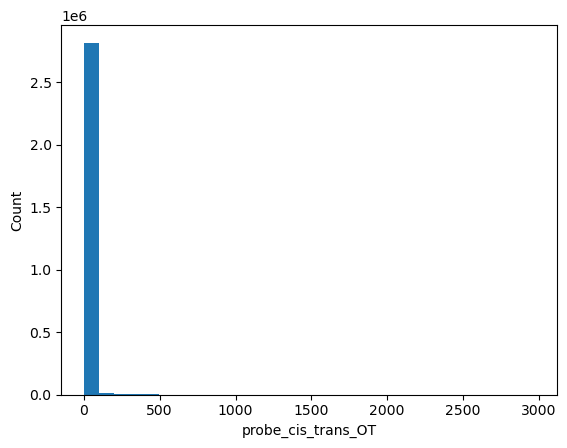

In [36]:
# The off-targets in this table indicates cis/trans-complementarity
ot.calc_OTs(probe_dict, ottable_probes_rc, 'capture_target_sequence', 'probe_cis_trans_OT', 15)
# plot
plot.plot_hist(probe_dict, 'probe_cis_trans_OT')

In [37]:
# based on the previous, set the cutoff to be 10:
cutoff = 10
# Remove probes that have any cis/trans-complementarity
filters.filter_probe_dict_by_metric(probe_dict, 'probe_cis_trans_OT', upper_bound=cutoff - 0.5)

Xkr4
	ENSMUST00000070533.5: 48 / 126 probes passed the filter -inf < probe_cis_trans_OT <  9.5.
Rp1
	ENSMUST00000208660.2: 64 / 172 probes passed the filter -inf < probe_cis_trans_OT <  9.5.
Sox17
	ENSMUST00000027035.10: 50 / 125 probes passed the filter -inf < probe_cis_trans_OT <  9.5.
Mrpl15
	ENSMUST00000156816.7: 48 / 120 probes passed the filter -inf < probe_cis_trans_OT <  9.5.
Lypla1
	ENSMUST00000027036.11: 1 / 5 probes passed the filter -inf < probe_cis_trans_OT <  9.5.
Tcea1
	ENSMUST00000081551.14: 0 / 5 probes passed the filter -inf < probe_cis_trans_OT <  9.5.
Rgs20
	ENSMUST00000002533.15: 15 / 37 probes passed the filter -inf < probe_cis_trans_OT <  9.5.
Atp6v1h
	ENSMUST00000192698.3: 32 / 67 probes passed the filter -inf < probe_cis_trans_OT <  9.5.
Oprk1
	ENSMUST00000160777.8: 25 / 94 probes passed the filter -inf < probe_cis_trans_OT <  9.5.
Npbwr1
	ENSMUST00000044180.5: 120 / 207 probes passed the filter -inf < probe_cis_trans_OT <  9.5.
Rb1cc1
	ENSMUST00000027040.13: 7

## Select non-overlapping probes

In [38]:
sel_pb_dict = {_k:_v for _k, _v in probe_dict.items() if max([len(_pbs) for _pbs in _v.values()]) > 0}

In [39]:
len(probe_dict) - len(sel_pb_dict)

2782

In [40]:
len(sel_pb_dict)

18783

In [41]:
sel_pb_dict = flex_probe_dict.select_probe_dict_by_distance(
    sel_pb_dict,
    distance=1,
    target_sequence_column='target_sequence',
)

In [43]:
# plot probe number:
probe_num = [max([len(_pbs) for _pbs in _v.values()]) for _k, _v in sel_pb_dict.items()]

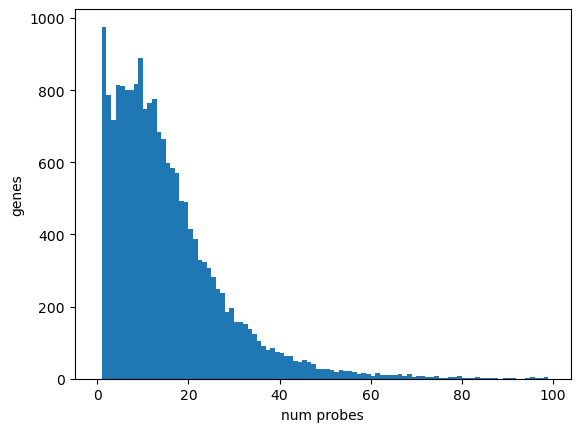

In [44]:
import matplotlib.pyplot as plt
plt.figure()
plt.hist(probe_num, bins=np.arange(100))
plt.xlabel('num probes')
plt.ylabel('genes')
plt.show()

In [45]:
len(probe_num)

18783

## Save non-overlapping candidates

In [46]:
# save probe_dict as current form:

nonoverlap_probe_dict_filename = os.path.join(
    library_folder, 
    f'{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_sel_nonoverlapping_probe_dict.pkl')

print(nonoverlap_probe_dict_filename)
pickle.dump(sel_pb_dict, open(nonoverlap_probe_dict_filename,'wb'))

/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/2025_7_31_sel_nonoverlapping_probe_dict.pkl


### restart from here:

In [42]:
# Optional: keep all the probes for WholeBrain genes:

# select wb genes:
# load MERFISH gene list:
codebook = pd.read_csv(r'/lab/solexa_weissman/puzheng/MERFISH_Probes/ZhuangLab_MERFISH/WB/codebook_32bit_v2.csv')
wb_genes = [_g for _g in codebook['name'] if 'blank-' not in _g]
gene_name_mapping = {
    'Fam84b':'Lratd2',
    'Prrxl1':'Drgx',
    'Fyb':'Fyb1',
    'Fam19a2':'Tafa2',
    'Fam46a':'Tent5a',
    'Fam19a4':'Tafa4',
    'Kirrel':'Kirrel1',
    'Fam196b':'Insyn2b',
    'BC030499':'Rskr',
    'Ctgf':'Ccn2',
    'Nov':'Ccn3',
    'Wisp1':'Ccn4',
    'Slc9a3r1':'Nherf1',
    'Arntl':'Bmal1',
    'Fam122b':'Pabir2',
    'Pifo':'Cimap3',
    'Fam19a1':'Tafa1',
}
sel_wb_genes = []
for _g in wb_genes:
    if _g not in sel_pb_dict:
        if _g in gene_name_mapping and gene_name_mapping[_g] in sel_pb_dict:
            sel_wb_genes.append(gene_name_mapping[_g])
    else:
        sel_wb_genes.append(_g)
# extract all probes:
wb_pb_dict = {_k:_v for _k,_v in sel_pb_dict.items() if _k in sel_wb_genes}
print(len(wb_pb_dict))

### For the rest of genes, still select 2:

In [47]:
# select top2 probes:
sel_pb_dict = flex_probe_dict.select_probe_dict_by_value(
    sel_pb_dict,
    value='target_isospecificity',
    num_keep=2,
    ascending=True,
)

In [48]:
select_all_wb = False
if select_all_wb:
    # replace if this gene is in wb_pb_dict:
    for _g, _value in wb_pb_dict.items():
        sel_pb_dict[_g] = _value

In [49]:
sel_pb_dict['Cd4']['ENSMUST00000024044.7'].head()

,gene_id,transcript_id,shift,target_sequence,target_GC_left25,target_GC_right25,target_base_at_location25,has_homopolymer5,target_OT_rtRNA,target_specificity,target_isospecificity,capture_target_sequence,capture_sequence,capture_sequence_name,capture_target_sequence_sequencing_primer,sequencing_primer_sequence,sequencing_primer_sequence_name,probe_cis_trans_OT
0,Cd4,ENSMUST00000024044.7,81,CTCGAGCCCTCATATACACACACCTGTGCAAGAAGCAGAGTGAAGG...,52.0,52.0,4,0,0,0.992647,0.01,TTGCTAGGACCGGCCTTAAAGCCTCGAGCCCTCATATACACACACC...,TTGCTAGGACCGGCCTTAAAGC,10x_Capture_1,TTGCTAGGACCGGCCTTAAAGCCTCGAGCCCTCATATACACACACC...,TGGAATTCTCGGGTGCCAAGG,Read2S,7
1,Cd4,ENSMUST00000024044.7,138,AGAGGCTCAGATTCCCAACCAACAAGAGCTCAAGGAGACCACCATG...,48.0,60.0,4,0,0,1.000000,0.01,TTGCTAGGACCGGCCTTAAAGCAGAGGCTCAGATTCCCAACCAACA...,TTGCTAGGACCGGCCTTAAAGC,10x_Capture_1,TTGCTAGGACCGGCCTTAAAGCAGAGGCTCAGATTCCCAACCAACA...,TGGAATTCTCGGGTGCCAAGG,Read2S,9


In [50]:
sel_pb_dict['Pax2']['ENSMUST00000174490.9'].head()

,gene_id,transcript_id,shift,target_sequence,target_GC_left25,target_GC_right25,target_base_at_location25,has_homopolymer5,target_OT_rtRNA,target_specificity,target_isospecificity,capture_target_sequence,capture_sequence,capture_sequence_name,capture_target_sequence_sequencing_primer,sequencing_primer_sequence,sequencing_primer_sequence_name,probe_cis_trans_OT
0,Pax2,ENSMUST00000174490.9,0,TGCTGGGCACTTTGCCCCGGAATGAGAATCATGCGTGCGTGGATGG...,60.0,56.0,4,0,0,1.0,0.01,TTGCTAGGACCGGCCTTAAAGCTGCTGGGCACTTTGCCCCGGAATG...,TTGCTAGGACCGGCCTTAAAGC,10x_Capture_1,TTGCTAGGACCGGCCTTAAAGCTGCTGGGCACTTTGCCCCGGAATG...,TGGAATTCTCGGGTGCCAAGG,Read2S,3
1,Pax2,ENSMUST00000174490.9,4030,CTCCCACTTCATCTCCCTTTTCTCTGCTACTCTCGACCCCTCTGTG...,48.0,60.0,4,0,0,1.0,0.01,TTGCTAGGACCGGCCTTAAAGCCTCCCACTTCATCTCCCTTTTCTC...,TTGCTAGGACCGGCCTTAAAGC,10x_Capture_1,TTGCTAGGACCGGCCTTAAAGCCTCCCACTTCATCTCCCTTTTCTC...,TGGAATTCTCGGGTGCCAAGG,Read2S,2


In [51]:
flex_probe_dict.name_full_flex_probe_dict(
    sel_pb_dict,
    capture_seq_column='capture_sequence',
    primer_seq_column='sequencing_primer_sequence',
    input_column='capture_target_sequence_sequencing_primer',
    output_key='flex_probe_basename',
)


## split sel_pb_dict into left and right probes

In [52]:
left_probe_dict, right_probe_dict = flex_probe_dict.split_flex_probe_dict(
    sel_pb_dict,
    input_column='capture_target_sequence_sequencing_primer',
    capture_seq_column='capture_sequence',
    primer_seq_column='sequencing_primer_sequence',
    output_key='Flex_probe_sequence',
)

Processing Gene: Xkr4
Processing Transcript: ENSMUST00000070533.5
Processing Gene: Rp1
Processing Transcript: ENSMUST00000208660.2
Processing Gene: Sox17
Processing Transcript: ENSMUST00000027035.10
Processing Gene: Mrpl15
Processing Transcript: ENSMUST00000156816.7
Processing Gene: Lypla1
Processing Transcript: ENSMUST00000027036.11
Processing Gene: Rgs20
Processing Transcript: ENSMUST00000002533.15
Processing Gene: Atp6v1h
Processing Transcript: ENSMUST00000192698.3
Processing Gene: Oprk1
Processing Transcript: ENSMUST00000160777.8
Processing Gene: Npbwr1
Processing Transcript: ENSMUST00000044180.5
Processing Gene: Rb1cc1
Processing Transcript: ENSMUST00000027040.13
Processing Gene: Alkal1
Processing Transcript: ENSMUST00000133144.4
Processing Gene: St18
Processing Transcript: ENSMUST00000043578.13
Processing Gene: Pcmtd1
Processing Transcript: ENSMUST00000061280.17
Processing Gene: Sntg1
Processing Transcript: ENSMUST00000140295.8
Processing Gene: Rrs1
Processing Transcript: ENSMUST

# Add primers

In [53]:
# Define primer sequences
forward_primer_file = os.path.join(reference_folder, 'Primers',
                                   r'illumina_P7.fasta')
reverse_primer_file = os.path.join(reference_folder, 'Primers',
                                   r'SP6_flex.fasta')
                                   #r'T7_reverse_primers.fasta')
selected_primers_file = os.path.join(library_folder, 'selected_primers.csv')

print(os.path.isfile(forward_primer_file), os.path.isfile(reverse_primer_file))

True True


In [54]:
forward_primers, reverse_primers = fio.load_primers(forward_primer_file, reverse_primer_file)

In [55]:
display(forward_primers)
display(reverse_primers)

,id,description,sequence,sequence_rc
0,P7,P7,CAAGCAGAAGACGGCATACGAGAT,ATCTCGTATGCCGTCTTCTGCTTG


,id,description,sequence,sequence_rc
0,P5-SP6,P5-SP6,AATGATACGGCGACCACCGAATTTAGGTGACACTATAG,CTATAGTGTCACCTAAATTCGGTGGTCGCCGTATCATT
1,Read1s-SP6,Read1s-SP6,GAGCACACGTCTGAACTCCAGTCAATTTAGGTGACACTATAG,CTATAGTGTCACCTAAATTGACTGGAGTTCAGACGTGTGCTC


In [56]:
ottable_target_readout = ot.get_OTTable_for_probe_dictionary(left_probe_dict, 'Flex_probe_sequence', 15)
# Calculate the off-targets for the primer sequences and their reverse-complements
# Usually, there shouln't be any off-targets
ot.calc_OTs_df(forward_primers, ottable_target_readout, 'sequence', 'sequence_OT', 15)
ot.calc_OTs_df(forward_primers, ottable_target_readout, 'sequence_rc', 'sequence_rc_OT', 15)
ot.calc_OTs_df(reverse_primers, ottable_target_readout, 'sequence', 'sequence_OT', 15)
ot.calc_OTs_df(reverse_primers, ottable_target_readout, 'sequence_rc', 'sequence_rc_OT', 15)
# Display primer OT tables to manually select
display(forward_primers)
display(reverse_primers)

,id,description,sequence,sequence_rc,sequence_OT,sequence_rc_OT
0,P7,P7,CAAGCAGAAGACGGCATACGAGAT,ATCTCGTATGCCGTCTTCTGCTTG,0,0


,id,description,sequence,sequence_rc,sequence_OT,sequence_rc_OT
0,P5-SP6,P5-SP6,AATGATACGGCGACCACCGAATTTAGGTGACACTATAG,CTATAGTGTCACCTAAATTCGGTGGTCGCCGTATCATT,0,0
1,Read1s-SP6,Read1s-SP6,GAGCACACGTCTGAACTCCAGTCAATTTAGGTGACACTATAG,CTATAGTGTCACCTAAATTGACTGGAGTTCAGACGTGTGCTC,0,0


In [57]:
# NOTE: the sequence after primer addition should be (reverse_primer)-(target_readouts)-(forward_primer_rc)
primer_design.add_primer_sequences(left_probe_dict, 
                                   reverse_primers.iloc[0]['sequence'].lower(), 
                                   forward_primers.iloc[0]['sequence_rc'].lower(), ## In this case don't add forward primers at all
                input_column='Flex_probe_sequence', output_column='primer_Flex_probe_sequence')

In [58]:
left_probe_dict['Pax2']['ENSMUST00000174490.9']['primer_Flex_probe_sequence'][0]

'aatgatacggcgaccaccgaatttaggtgacactatagTTGCTAGGACCGGCCTTAAAGCTGCTGGGCACTTTGCCCCGGAATGAatctcgtatgccgtcttctgcttg'

In [59]:
# NOTE: the sequence after primer addition should be (reverse_primer)-(target_readouts)-(forward_primer_rc)
primer_design.add_primer_sequences(right_probe_dict, 
                                   reverse_primers.iloc[1]['sequence'].lower()[:-1], #REMOVE extra G! 
                                   "", # no need to add anything, use Read2S 
                input_column='Flex_probe_sequence', output_column='primer_Flex_probe_sequence')

In [60]:
p_d.get_rc_sequences(left_probe_dict, 'Flex_probe_sequence', 'Flex_probe_sequence_rc')
p_d.get_rc_sequences(left_probe_dict, 'primer_Flex_probe_sequence', 'primer_Flex_probe_sequence_rc')

p_d.get_rc_sequences(right_probe_dict, 'Flex_probe_sequence', 'Flex_probe_sequence_rc')
p_d.get_rc_sequences(right_probe_dict, 'primer_Flex_probe_sequence', 'primer_Flex_probe_sequence_rc')

In [61]:
left_probe_dict['Pax2']['ENSMUST00000174490.9']['primer_Flex_probe_sequence_rc'][0]

'caagcagaagacggcatacgagatTCATTCCGGGGCAAAGTGCCCAGCAGCTTTAAGGCCGGTCCTAGCAActatagtgtcacctaaattcggtggtcgccgtatcatt'

In [62]:
right_probe_dict['Pax2']['ENSMUST00000174490.9']['primer_Flex_probe_sequence_rc'][0]

'CCTTGGCACCCGAGAATTCCACTTCCCATCCACGCACGCATGATTCtatagtgtcacctaaattgactggagttcagacgtgtgctc'

## Merge into one DF, swap back L and R

In [63]:
# assemble into df:
# Right probe -> LHS after RC
df_LHS_probes = p_d.probe_dict_to_df(right_probe_dict).sort_values(['gene_id','shift'], ignore_index=True)
df_LHS_probes.head()
# reset final names:
LHS_probe_names = [_n.replace('_right','_LHS'+f"_{reverse_primers.iloc[1]['id']}rc") for _n in df_LHS_probes['Flex_probe_sequence_name']]
df_LHS_probes['final_probe_name'] = pd.Series(LHS_probe_names)

In [64]:
df_LHS_probes.loc[0,'Flex_probe_sequence_name']

'0610030E20Rik_ENSMUST00000077783.5_shift:65_GC:68.0_specificity:1.00_isospecificity:0.01_seqprimer:Read2S_right'

In [65]:
df_LHS_probes.loc[0,'final_probe_name']

'0610030E20Rik_ENSMUST00000077783.5_shift:65_GC:68.0_specificity:1.00_isospecificity:0.01_seqprimer:Read2S_LHS_Read1s-SP6rc'

In [66]:
df_LHS_probes

,gene_id,transcript_id,shift,target_GC_left25,target_GC_right25,target_base_at_location25,has_homopolymer5,target_OT_rtRNA,target_specificity,target_isospecificity,...,probe_cis_trans_OT,flex_probe_basename,target_sequence,original_target_sequence,Flex_probe_sequence,Flex_probe_sequence_name,primer_Flex_probe_sequence,Flex_probe_sequence_rc,primer_Flex_probe_sequence_rc,final_probe_name
0,0610030E20Rik,ENSMUST00000077783.5,65,64.0,68.0,4,0,0,1.0,0.010000,...,9,0610030E20Rik_ENSMUST00000077783.5_shift:65_GC...,GATCACGGGCCGGGGTTGTGCTGCA,CAGCATACGAATGGAGGCGGCCCAGGATCACGGGCCGGGGTTGTGC...,GATCACGGGCCGGGGTTGTGCTGCATGGAATTCTCGGGTGCCAAGG,0610030E20Rik_ENSMUST00000077783.5_shift:65_GC...,gagcacacgtctgaactccagtcaatttaggtgacactataGATCA...,CCTTGGCACCCGAGAATTCCATGCAGCACAACCCCGGCCCGTGATC,CCTTGGCACCCGAGAATTCCATGCAGCACAACCCCGGCCCGTGATC...,0610030E20Rik_ENSMUST00000077783.5_shift:65_GC...
1,0610030E20Rik,ENSMUST00000077783.5,2564,48.0,48.0,4,0,0,1.0,0.010000,...,0,0610030E20Rik_ENSMUST00000077783.5_shift:2564_...,GGTCGGGACAAAGAACATTGGAACT,GAAACACAGGATTCACTGGAACGCTGGTCGGGACAAAGAACATTGG...,GGTCGGGACAAAGAACATTGGAACTTGGAATTCTCGGGTGCCAAGG,0610030E20Rik_ENSMUST00000077783.5_shift:2564_...,gagcacacgtctgaactccagtcaatttaggtgacactataGGTCG...,CCTTGGCACCCGAGAATTCCAAGTTCCAATGTTCTTTGTCCCGACC,CCTTGGCACCCGAGAATTCCAAGTTCCAATGTTCTTTGTCCCGACC...,0610030E20Rik_ENSMUST00000077783.5_shift:2564_...
2,0610040J01Rik,ENSMUST00000081747.8,16,68.0,68.0,4,0,0,1.0,0.010000,...,0,0610040J01Rik_ENSMUST00000081747.8_shift:16_GC...,GGGTTACCCTTGCCTGGGAGGCTCG,GCACGCGGGCCAAGGCGCAGGTAAAGGGTTACCCTTGCCTGGGAGG...,GGGTTACCCTTGCCTGGGAGGCTCGTGGAATTCTCGGGTGCCAAGG,0610040J01Rik_ENSMUST00000081747.8_shift:16_GC...,gagcacacgtctgaactccagtcaatttaggtgacactataGGGTT...,CCTTGGCACCCGAGAATTCCACGAGCCTCCCAGGCAAGGGTAACCC,CCTTGGCACCCGAGAATTCCACGAGCCTCCCAGGCAAGGGTAACCC...,0610040J01Rik_ENSMUST00000081747.8_shift:16_GC...
3,0610040J01Rik,ENSMUST00000081747.8,230,52.0,60.0,4,0,0,1.0,0.010000,...,5,0610040J01Rik_ENSMUST00000081747.8_shift:230_G...,GAAGCCTAATGGACAAGCGCCCCAG,CAGGAAGAGCGGTTTAACACCCAGAGAAGCCTAATGGACAAGCGCC...,GAAGCCTAATGGACAAGCGCCCCAGTGGAATTCTCGGGTGCCAAGG,0610040J01Rik_ENSMUST00000081747.8_shift:230_G...,gagcacacgtctgaactccagtcaatttaggtgacactataGAAGC...,CCTTGGCACCCGAGAATTCCACTGGGGCGCTTGTCCATTAGGCTTC,CCTTGGCACCCGAGAATTCCACTGGGGCGCTTGTCCATTAGGCTTC...,0610040J01Rik_ENSMUST00000081747.8_shift:230_G...
4,1110002E22Rik,ENSMUST00000163080.3,5,52.0,56.0,4,0,0,1.0,0.010000,...,0,1110002E22Rik_ENSMUST00000163080.3_shift:5_GC:...,GTCCGACCTACAGATGCTGCTTCGT,TTCCGTTCATTTCTGGCAGACCCCTGTCCGACCTACAGATGCTGCT...,GTCCGACCTACAGATGCTGCTTCGTTGGAATTCTCGGGTGCCAAGG,1110002E22Rik_ENSMUST00000163080.3_shift:5_GC:...,gagcacacgtctgaactccagtcaatttaggtgacactataGTCCG...,CCTTGGCACCCGAGAATTCCAACGAAGCAGCATCTGTAGGTCGGAC,CCTTGGCACCCGAGAATTCCAACGAAGCAGCATCTGTAGGTCGGAC...,1110002E22Rik_ENSMUST00000163080.3_shift:5_GC:...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36585,a,ENSMUST00000029123.3,186,64.0,56.0,4,0,0,1.0,0.250000,...,8,a_ENSMUST00000029123.3_shift:186_GC:64.0-56.0_...,GGAGATGACAGGAGTCTGCGGAGTA,CCACCTGGCACTCGAGGAGACGCTTGGAGATGACAGGAGTCTGCGG...,GGAGATGACAGGAGTCTGCGGAGTATGGAATTCTCGGGTGCCAAGG,a_ENSMUST00000029123.3_shift:186_GC:56.0_speci...,gagcacacgtctgaactccagtcaatttaggtgacactataGGAGA...,CCTTGGCACCCGAGAATTCCATACTCCGCAGACTCCTGTCATCTCC,CCTTGGCACCCGAGAATTCCATACTCCGCAGACTCCTGTCATCTCC...,a_ENSMUST00000029123.3_shift:186_GC:56.0_speci...
36586,a,ENSMUST00000029123.3,487,52.0,68.0,4,0,0,1.0,0.333333,...,0,a_ENSMUST00000029123.3_shift:487_GC:52.0-68.0_...,GCTGACGCAGCTTCTTCGCTGCGCG,ACCTGTCGAGTACTCAACCCCAACTGCTGACGCAGCTTCTTCGCTG...,GCTGACGCAGCTTCTTCGCTGCGCGTGGAATTCTCGGGTGCCAAGG,a_ENSMUST00000029123.3_shift:487_GC:68.0_speci...,gagcacacgtctgaactccagtcaatttaggtgacactataGCTGA...,CCTTGGCACCCGAGAATTCCACGCGCAGCGAAGAAGCTGCGTCAGC,CCTTGGCACCCGAGAATTCCACGCGCAGCGAAGAAGCTGCGTCAGC...,a_ENSMUST00000029123.3_shift:487_GC:68.0_speci...
36587,mt-Nd4,ENSMUST00000082414.1,990,48.0,56.0,4,0,0,1.0,0.010000,..

In [67]:
# Left probe -> RHS after RC
df_RHS_probes = p_d.probe_dict_to_df(left_probe_dict).sort_values(['gene_id','shift'], ignore_index=True)
df_RHS_probes.head()

RHS_probe_names = [_n.replace('_left','_RHS'+f"_{forward_primers.iloc[0]['id']}_{reverse_primers.iloc[0]['id']}rc") for _n in df_RHS_probes['Flex_probe_sequence_name']]
df_RHS_probes['final_probe_name'] = pd.Series(RHS_probe_names)

In [68]:
df_RHS_probes

,gene_id,transcript_id,shift,target_GC_left25,target_GC_right25,target_base_at_location25,has_homopolymer5,target_OT_rtRNA,target_specificity,target_isospecificity,...,probe_cis_trans_OT,flex_probe_basename,target_sequence,original_target_sequence,Flex_probe_sequence,Flex_probe_sequence_name,primer_Flex_probe_sequence,Flex_probe_sequence_rc,primer_Flex_probe_sequence_rc,final_probe_name
0,0610030E20Rik,ENSMUST00000077783.5,65,64.0,68.0,4,0,0,1.0,0.010000,...,9,0610030E20Rik_ENSMUST00000077783.5_shift:65_GC...,CAGCATACGAATGGAGGCGGCCCAG,CAGCATACGAATGGAGGCGGCCCAGGATCACGGGCCGGGGTTGTGC...,TTGCTAGGACCGGCCTTAAAGCCAGCATACGAATGGAGGCGGCCCAG,0610030E20Rik_ENSMUST00000077783.5_shift:65_GC...,aatgatacggcgaccaccgaatttaggtgacactatagTTGCTAGG...,CTGGGCCGCCTCCATTCGTATGCTGGCTTTAAGGCCGGTCCTAGCAA,caagcagaagacggcatacgagatCTGGGCCGCCTCCATTCGTATG...,0610030E20Rik_ENSMUST00000077783.5_shift:65_GC...
1,0610030E20Rik,ENSMUST00000077783.5,2564,48.0,48.0,4,0,0,1.0,0.010000,...,0,0610030E20Rik_ENSMUST00000077783.5_shift:2564_...,GAAACACAGGATTCACTGGAACGCT,GAAACACAGGATTCACTGGAACGCTGGTCGGGACAAAGAACATTGG...,TTGCTAGGACCGGCCTTAAAGCGAAACACAGGATTCACTGGAACGCT,0610030E20Rik_ENSMUST00000077783.5_shift:2564_...,aatgatacggcgaccaccgaatttaggtgacactatagTTGCTAGG...,AGCGTTCCAGTGAATCCTGTGTTTCGCTTTAAGGCCGGTCCTAGCAA,caagcagaagacggcatacgagatAGCGTTCCAGTGAATCCTGTGT...,0610030E20Rik_ENSMUST00000077783.5_shift:2564_...
2,0610040J01Rik,ENSMUST00000081747.8,16,68.0,68.0,4,0,0,1.0,0.010000,...,0,0610040J01Rik_ENSMUST00000081747.8_shift:16_GC...,GCACGCGGGCCAAGGCGCAGGTAAA,GCACGCGGGCCAAGGCGCAGGTAAAGGGTTACCCTTGCCTGGGAGG...,TTGCTAGGACCGGCCTTAAAGCGCACGCGGGCCAAGGCGCAGGTAAA,0610040J01Rik_ENSMUST00000081747.8_shift:16_GC...,aatgatacggcgaccaccgaatttaggtgacactatagTTGCTAGG...,TTTACCTGCGCCTTGGCCCGCGTGCGCTTTAAGGCCGGTCCTAGCAA,caagcagaagacggcatacgagatTTTACCTGCGCCTTGGCCCGCG...,0610040J01Rik_ENSMUST00000081747.8_shift:16_GC...
3,0610040J01Rik,ENSMUST00000081747.8,230,52.0,60.0,4,0,0,1.0,0.010000,...,5,0610040J01Rik_ENSMUST00000081747.8_shift:230_G...,CAGGAAGAGCGGTTTAACACCCAGA,CAGGAAGAGCGGTTTAACACCCAGAGAAGCCTAATGGACAAGCGCC...,TTGCTAGGACCGGCCTTAAAGCCAGGAAGAGCGGTTTAACACCCAGA,0610040J01Rik_ENSMUST00000081747.8_shift:230_G...,aatgatacggcgaccaccgaatttaggtgacactatagTTGCTAGG...,TCTGGGTGTTAAACCGCTCTTCCTGGCTTTAAGGCCGGTCCTAGCAA,caagcagaagacggcatacgagatTCTGGGTGTTAAACCGCTCTTC...,0610040J01Rik_ENSMUST00000081747.8_shift:230_G...
4,1110002E22Rik,ENSMUST00000163080.3,5,52.0,56.0,4,0,0,1.0,0.010000,...,0,1110002E22Rik_ENSMUST00000163080.3_shift:5_GC:...,TTCCGTTCATTTCTGGCAGACCCCT,TTCCGTTCATTTCTGGCAGACCCCTGTCCGACCTACAGATGCTGCT...,TTGCTAGGACCGGCCTTAAAGCTTCCGTTCATTTCTGGCAGACCCCT,1110002E22Rik_ENSMUST00000163080.3_shift:5_GC:...,aatgatacggcgaccaccgaatttaggtgacactatagTTGCTAGG...,AGGGGTCTGCCAGAAATGAACGGAAGCTTTAAGGCCGGTCCTAGCAA,caagcagaagacggcatacgagatAGGGGTCTGCCAGAAATGAACG...,1110002E22Rik_ENSMUST00000163080.3_shift:5_GC:...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36585,a,ENSMUST00000029123.3,186,64.0,56.0,4,0,0,1.0,0.250000,...,8,a_ENSMUST00000029123.3_shift:186_GC:64.0-56.0_...,CCACCTGGCACTCGAGGAGACGCTT,CCACCTGGCACTCGAGGAGACGCTTGGAGATGACAGGAGTCTGCGG...,TTGCTAGGACCGGCCTTAAAGCCCACCTGGCACTCGAGGAGACGCTT,a_ENSMUST00000029123.3_shift:186_GC:64.0_speci...,aatgatacggcgaccaccgaatttaggtgacactatagTTGCTAGG...,AAGCGTCTCCTCGAGTGCCAGGTGGGCTTTAAGGCCGGTCCTAGCAA,caagcagaagacggcatacgagatAAGCGTCTCCTCGAGTGCCAGG...,a_ENSMUST00000029123.3_shift:186_GC:64.0_speci...
36586,a,ENSMUST00000029123.3,487,52.0,68.0,4,0,0,1.0,0.333333,...,0,a_ENSMUST00000029123.3_shift:487_GC:52.0-68.0_...,ACCTGTCGAGTACTCAACCCCAACT,ACCTGTCGAGTACTCAACCCCAACTGCTGACGCAGCTTCTTCGCTG...,TTGCTAGGACCGGCCTTAAAGCACCTGTCGAGTACTCAACCCCAACT,a_ENSMUST00000029123.3_shift:487_GC:52.0_speci...,aatgatacggcgaccaccgaatttaggtgacactatagTTGCTAGG...,AGTTGGGGTTGAGTACTCGACAGGTGCTTTAAGGCCGGTCCTAGCAA,caagcagaagacggcatacgagatAGTTGGGGTTGAGTACTCGACA...,a_ENSMUST00000029123.3_shift:487_GC:52.0_speci...
36587,mt-Nd4,ENSMUST00000082414.1,990,48.0,56.0,4,0,0,1

In [69]:
df_RHS_probes.loc[0,'Flex_probe_sequence_name']

'0610030E20Rik_ENSMUST00000077783.5_shift:65_GC:64.0_specificity:1.00_isospecificity:0.01_capture:10x-Capture-1_left'

In [70]:
df_RHS_probes.loc[0,'final_probe_name']

'0610030E20Rik_ENSMUST00000077783.5_shift:65_GC:64.0_specificity:1.00_isospecificity:0.01_capture:10x-Capture-1_RHS_P7_P5-SP6rc'

# For the full probe set, save for reference:

In [71]:
p_d.get_rc_sequences(sel_pb_dict, 'capture_target_sequence_sequencing_primer', 'capture_target_sequence_sequencing_primer_rc')

df_full_probes = p_d.probe_dict_to_df(sel_pb_dict).sort_values(['gene_id','shift'],ignore_index=True)

In [72]:
df_full_probes.loc[0,'flex_probe_basename'], df_full_probes.loc[0,'capture_target_sequence_sequencing_primer_rc']

('0610030E20Rik_ENSMUST00000077783.5_shift:65_GC:64.0-68.0_specificity:1.00_isospecificity:0.01_capture:10x-Capture-1_seqprimer:Read2S',
 'CCTTGGCACCCGAGAATTCCATGCAGCACAACCCCGGCCCGTGATCCTGGGCCGCCTCCATTCGTATGCTGGCTTTAAGGCCGGTCCTAGCAA')

# Save

In [73]:
# save full versions:

LHS_savefile = os.path.join(
    library_folder, 
    f'{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_LHS_all_information.xlsx')
print(LHS_savefile)
df_LHS_probes.to_excel(LHS_savefile, index=False)

/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/2025_7_31_LHS_all_information.xlsx


In [74]:
RHS_savefile = os.path.join(
    library_folder, 
    f'{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_RHS_all_information.xlsx')
print(RHS_savefile)
df_RHS_probes.to_excel(RHS_savefile, index=False)

/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/2025_7_31_RHS_all_information.xlsx


In [75]:
full_probe_savefile = os.path.join(
    library_folder, 
    f'{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_full_probe_all_information.xlsx')
print(full_probe_savefile)
df_full_probes.to_excel(full_probe_savefile, index=False)

/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/2025_7_31_full_probe_all_information.xlsx


## Save minimal versions

In [76]:
LHS_library_file = os.path.join(
    library_folder, 
    f'{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_LHS_library.csv')
clean_LHS_probes = df_LHS_probes[['final_probe_name','primer_Flex_probe_sequence_rc']]\
.rename(columns={'final_probe_name':'name', 'primer_Flex_probe_sequence_rc':'sequence'})
print(LHS_library_file)
clean_LHS_probes.to_csv(LHS_library_file, index=False)

/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/2025_7_31_LHS_library.csv


In [77]:
RHS_library_file = os.path.join(
    library_folder, 
    f'{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_RHS_library.csv')
clean_RHS_probes = df_RHS_probes[['final_probe_name','primer_Flex_probe_sequence_rc']]\
.rename(columns={'final_probe_name':'name', 'primer_Flex_probe_sequence_rc':'sequence'})
print(RHS_library_file)
clean_RHS_probes.to_csv(RHS_library_file, index=False)

/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/2025_7_31_RHS_library.csv


In [78]:
full_probe_library_file = os.path.join(
    library_folder, 
    f'{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_full_probe_library.csv')
clean_full_probes = df_full_probes[['flex_probe_basename','capture_target_sequence_sequencing_primer_rc']]\
.rename(columns={'flex_probe_basename':'name', 'capture_target_sequence_sequencing_primer_rc':'sequence'})
print(full_probe_library_file)
clean_full_probes.to_csv(full_probe_library_file, index=False)

/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/2025_7_31_full_probe_library.csv


## Save the no-primer version, can be ordered through IDT

In [79]:
df_LHS_probes.head()

,gene_id,transcript_id,shift,target_GC_left25,target_GC_right25,target_base_at_location25,has_homopolymer5,target_OT_rtRNA,target_specificity,target_isospecificity,...,probe_cis_trans_OT,flex_probe_basename,target_sequence,original_target_sequence,Flex_probe_sequence,Flex_probe_sequence_name,primer_Flex_probe_sequence,Flex_probe_sequence_rc,primer_Flex_probe_sequence_rc,final_probe_name
0,0610030E20Rik,ENSMUST00000077783.5,65,64.0,68.0,4,0,0,1.0,0.01,...,9,0610030E20Rik_ENSMUST00000077783.5_shift:65_GC...,GATCACGGGCCGGGGTTGTGCTGCA,CAGCATACGAATGGAGGCGGCCCAGGATCACGGGCCGGGGTTGTGC...,GATCACGGGCCGGGGTTGTGCTGCATGGAATTCTCGGGTGCCAAGG,0610030E20Rik_ENSMUST00000077783.5_shift:65_GC...,gagcacacgtctgaactccagtcaatttaggtgacactataGATCA...,CCTTGGCACCCGAGAATTCCATGCAGCACAACCCCGGCCCGTGATC,CCTTGGCACCCGAGAATTCCATGCAGCACAACCCCGGCCCGTGATC...,0610030E20Rik_ENSMUST00000077783.5_shift:65_GC...
1,0610030E20Rik,ENSMUST00000077783.5,2564,48.0,48.0,4,0,0,1.0,0.01,...,0,0610030E20Rik_ENSMUST00000077783.5_shift:2564_...,GGTCGGGACAAAGAACATTGGAACT,GAAACACAGGATTCACTGGAACGCTGGTCGGGACAAAGAACATTGG...,GGTCGGGACAAAGAACATTGGAACTTGGAATTCTCGGGTGCCAAGG,0610030E20Rik_ENSMUST00000077783.5_shift:2564_...,gagcacacgtctgaactccagtcaatttaggtgacactataGGTCG...,CCTTGGCACCCGAGAATTCCAAGTTCCAATGTTCTTTGTCCCGACC,CCTTGGCACCCGAGAATTCCAAGTTCCAATGTTCTTTGTCCCGACC...,0610030E20Rik_ENSMUST00000077783.5_shift:2564_...
2,0610040J01Rik,ENSMUST00000081747.8,16,68.0,68.0,4,0,0,1.0,0.01,...,0,0610040J01Rik_ENSMUST00000081747.8_shift:16_GC...,GGGTTACCCTTGCCTGGGAGGCTCG,GCACGCGGGCCAAGGCGCAGGTAAAGGGTTACCCTTGCCTGGGAGG...,GGGTTACCCTTGCCTGGGAGGCTCGTGGAATTCTCGGGTGCCAAGG,0610040J01Rik_ENSMUST00000081747.8_shift:16_GC...,gagcacacgtctgaactccagtcaatttaggtgacactataGGGTT...,CCTTGGCACCCGAGAATTCCACGAGCCTCCCAGGCAAGGGTAACCC,CCTTGGCACCCGAGAATTCCACGAGCCTCCCAGGCAAGGGTAACCC...,0610040J01Rik_ENSMUST00000081747.8_shift:16_GC...
3,0610040J01Rik,ENSMUST00000081747.8,230,52.0,60.0,4,0,0,1.0,0.01,...,5,0610040J01Rik_ENSMUST00000081747.8_shift:230_G...,GAAGCCTAATGGACAAGCGCCCCAG,CAGGAAGAGCGGTTTAACACCCAGAGAAGCCTAATGGACAAGCGCC...,GAAGCCTAATGGACAAGCGCCCCAGTGGAATTCTCGGGTGCCAAGG,0610040J01Rik_ENSMUST00000081747.8_shift:230_G...,gagcacacgtctgaactccagtcaatttaggtgacactataGAAGC...,CCTTGGCACCCGAGAATTCCACTGGGGCGCTTGTCCATTAGGCTTC,CCTTGGCACCCGAGAATTCCACTGGGGCGCTTGTCCATTAGGCTTC...,0610040J01Rik_ENSMUST00000081747.8_shift:230_G...
4,1110002E22Rik,ENSMUST00000163080.3,5,52.0,56.0,4,0,0,1.0,0.01,...,0,1110002E22Rik_ENSMUST00000163080.3_shift:5_GC:...,GTCCGACCTACAGATGCTGCTTCGT,TTCCGTTCATTTCTGGCAGACCCCTGTCCGACCTACAGATGCTGCT...,GTCCGACCTACAGATGCTGCTTCGTTGGAATTCTCGGGTGCCAAGG,1110002E22Rik_ENSMUST00000163080.3_shift:5_GC:...,gagcacacgtctgaactccagtcaatttaggtgacactataGTCCG...,CCTTGGCACCCGAGAATTCCAACGAAGCAGCATCTGTAGGTCGGAC,CCTTGGCACCCGAGAATTCCAACGAAGCAGCATCTGTAGGTCGGAC...,1110002E22Rik_ENSMUST00000163080.3_shift:5_GC:...


In [80]:
short_LHS_probes = df_LHS_probes[['final_probe_name','Flex_probe_sequence_rc']]\
.rename(columns={'final_probe_name':'name', 'Flex_probe_sequence_rc':'Sequence'})
short_LHS_probes['Pool name'] = 'Flex_Read2S_148gene_LHS'

In [81]:
short_RHS_probes = df_RHS_probes[['final_probe_name','Flex_probe_sequence_rc']]\
.rename(columns={'final_probe_name':'name', 'Flex_probe_sequence_rc':'Sequence'})
short_RHS_probes['Pool name'] = 'Flex_148gene_RHS_10xcapture1'

In [82]:
idt_LHS_savefile = os.path.join(
    library_folder, 
    f'IDT_{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_LHS_short_probes.xlsx')
short_LHS_probes[['Pool name','Sequence']].to_excel(idt_LHS_savefile, index=False)

idt_RHS_savefile = os.path.join(
    library_folder, 
    f'IDT_{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_RHS_short_probes.xlsx')
short_RHS_probes[['Pool name','Sequence']].to_excel(idt_RHS_savefile, index=False)


In [83]:
# save these short probes:
idt_save_filename = os.path.join(
    library_folder, 
    f'IDT_{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_short_probes.xlsx')
print(idt_save_filename)
idt_save_df = pd.concat([short_LHS_probes[['Pool name','Sequence']],short_RHS_probes[['Pool name','Sequence']]])
print(len(idt_save_df))
idt_save_df.to_excel(idt_save_filename, index=False)

/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/IDT_2025_7_31_short_probes.xlsx
73180


## Save other information:

In [84]:
# primers:
used_primers = pd.concat([forward_primers, reverse_primers])
used_primers.to_csv(os.path.join(library_folder, 'used_primers.csv'), index=False)


In [85]:
# capture / seq-primer:
flex_element_filename = os.path.join(library_folder, 'flex_elements.csv')
Flex_Probe_Elements.to_csv(flex_element_filename, index=False)

In [86]:
len(clean_RHS_probes.loc[0, 'sequence']),len(clean_LHS_probes.loc[0, 'sequence'])

(109, 87)

In [87]:
# merge clean_RHS and clean_LHS:
merged_probe_filename = os.path.join(
    library_folder, 
    f'{localtime().tm_year}_{localtime().tm_mon}_{localtime().tm_mday}_merged_twist_library.csv')
print(merged_probe_filename)
merged_probes = pd.concat([clean_LHS_probes, clean_RHS_probes])
merged_probes.to_csv(merged_probe_filename, index=False)

/lab/solexa_weissman/puzheng/MERFISH_Probes/Flex_Probes/SP6_mouse_transcriptome_batch2/2025_7_31_merged_twist_library.csv
